In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

In [2]:
df = pd.read_csv("meteorites.csv")

In [3]:
# remove unwanted columns
unwanted = ['id', 'name_type', 'class', 'fall', 'geolocation']
df.drop(unwanted, axis=1, inplace=True)

In [4]:
# drop nall
df.dropna(inplace=True)

In [5]:
# convert year column from float to int
df.year = df.year.astype(np.int64)

In [6]:
# sort by column
sort_col = ['year', 'mass']
df.sort_values(by=sort_col, inplace=True)

In [7]:
# resize index
df.reset_index(drop=True, inplace=True)

In [8]:
df.head()

,name,mass,year,lat,long
0,Nogata,472.0,860,33.72500,130.75000
1,Elbogen,107000.0,1399,50.18333,12.73333
2,Rivolta de Bassi,103.3,1490,45.48333,9.51667
3,Ensisheim,127000.0,1491,47.86667,7.35000
4,Campo del Cielo,50000000.0,1575,-27.46667,-60.58333


In [13]:
# animated scatter mapbox
fig = px.scatter_mapbox(df, lat='lat',
                        lon='long',
                        hover_name="name",
                        hover_data=["name", "mass"],
                        color_discrete_sequence=["fuchsia"],
                        zoom=1.8,
                        height=1000,
                        animation_frame="year",)

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 600
fig.layout.updatemenus[0].buttons[0].args[1]["transition"]["duration"] = 600
fig.show()

In [15]:
fig = px.scatter_mapbox(df, 
                        lat='lat',
                        lon='long',
                        hover_name="name",
                        hover_data=["name", "mass"],
                        color_discrete_sequence=["fuchsia"],
                        zoom=1.8,
                        height=400,
                        width=600,
                        animation_frame="year",
                        size='mass',  # Size marker based on mass
                        size_max=100)  # Maximum size of the marker

# Update the map style and layout
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 600
fig.layout.updatemenus[0].buttons[0].args[1]["transition"]["duration"] = 600

# Show the figure
fig.show()

In [21]:
fig = px.scatter_mapbox(df, 
                        lat='lat', 
                        lon='long', 
                        hover_name="name", 
                        hover_data=["name", "mass"], 
                        color_discrete_sequence=["fuchsia"], 
                        zoom=1.8, 
                        height=400,
                        width=600,
                        # size='mass', # Size marker based on mass
                        # size_max=20   # Maximum size of the marker
                        )

# Update the map style and layout
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})

# Show the figure
fig.show()

In [9]:
fig = px.scatter_geo(df, lat="lat", lon="long", 
                     color="year", hover_name="name", 
                     projection="natural earth", size="mass",
                    size_max=50, color_continuous_scale=px.colors.sequential.Turbo,
                     range_color=[1500, 2023], title="Meteorites Impacting Earth 1500-2023")
fig.show()

<Axes: xlabel='year', ylabel='Count'>

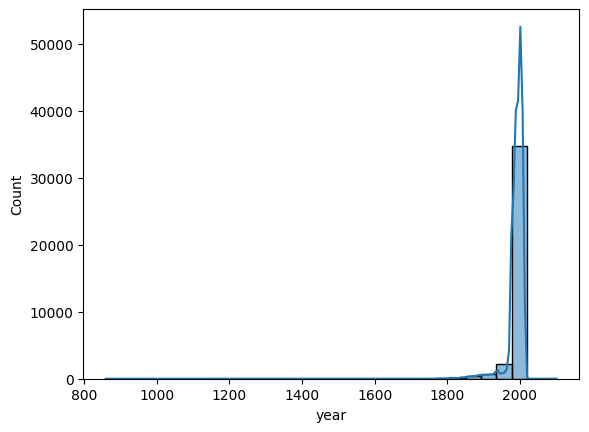

In [10]:
sns.histplot(data=df, x="year", bins=30, kde=True)

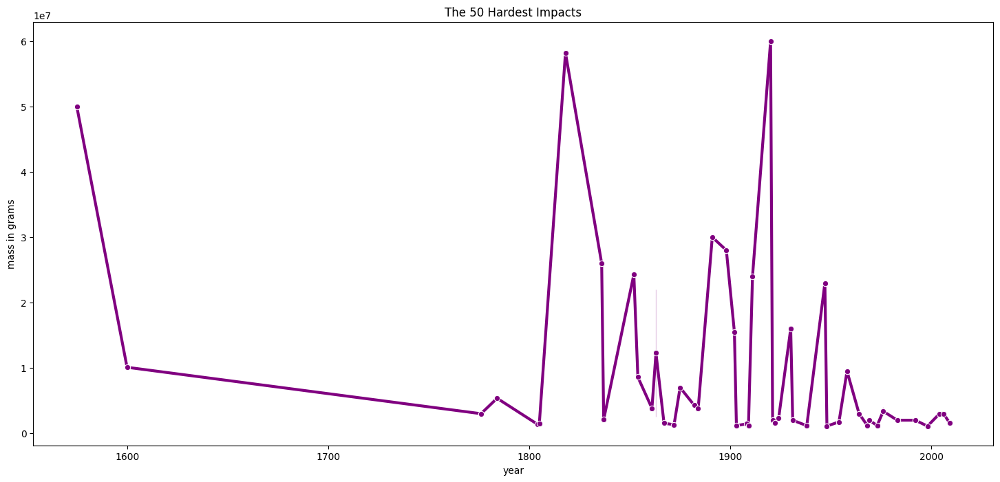

In [12]:
big50 = df.groupby(["year", "name"])["mass"].agg("sum").sort_values(ascending=False).head(50)
big50 = big50.sort_values(ascending=False).reset_index(name='mass in grams')

plt.figure(figsize=(18,8))
sns.lineplot(data=big50, x="year", y='mass in grams', color="purple", marker="o", linewidth=3).set_title("The 50 Hardest Impacts")
plt.show()

In [14]:
big50

,year,name,mass in grams
0,1920,Hoba,60000000.0
1,1818,Cape York,58200000.0
2,1575,Campo del Cielo,50000000.0
3,1891,Canyon Diablo,30000000.0
4,1898,Armanty,28000000.0
5,1836,Gibeon,26000000.0
6,1852,Chupaderos,24300000.0
7,1911,Mundrabilla,24000000.0
8,1947,Sikhote-Alin,23000000.0
9,1863,Bacubirito,22000000.0


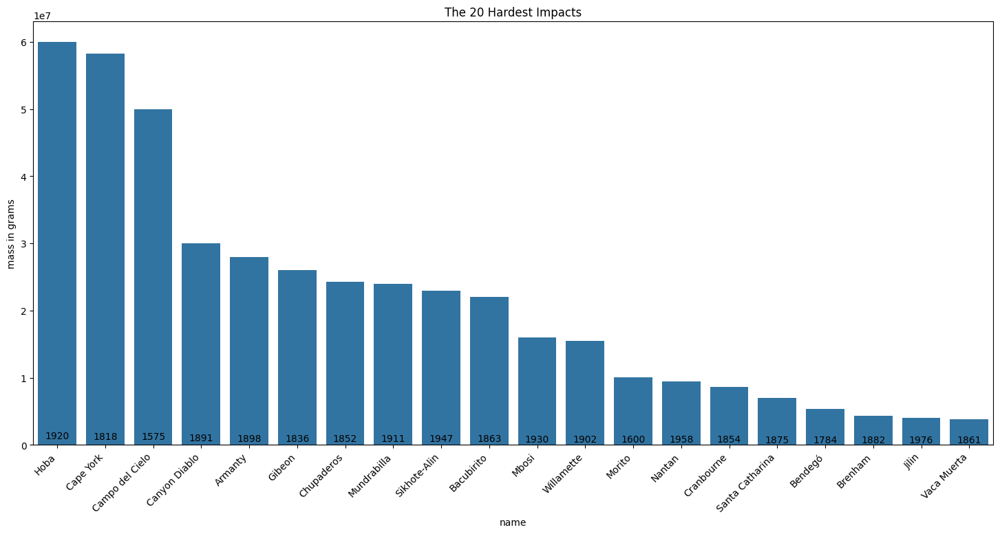

In [13]:

plt.figure(figsize=(18,8))
ax = sns.barplot(data=big50.head(20), x="name", y='mass in grams')
ax.set_title("The 20 Hardest Impacts")
plt.xticks(rotation=45, horizontalalignment='right')
for index, row in big50.head(20).iterrows():
    ax.text(row.name, row["mass in grams"]*0.01, int(row.year),
            color='black', ha='center', va='bottom')
plt.show()